In [2]:
from IPython.display import display
from IPython.display import HTML
import IPython.core.display as di # Example: di.display_html('<h3>%s:</h3>' % str, raw=True)

# This line will hide code by default when the notebook is exported as HTML
di.display_html('<script>jQuery(function() {if (jQuery("body.notebook_app").length == 0) { jQuery(".input_area").toggle(); jQuery(".prompt").toggle();}});</script>', raw=True)

# This line will add a button to toggle visibility of code blocks, for use with the HTML export version
di.display_html('''<button onclick="jQuery('.input_area').toggle(); jQuery('.prompt').toggle();">Toggle code</button>''', raw=True)

Toggle code

In [3]:
import os
from pathlib import Path
import pandas as pd
import numpy as np
import boto3
import datetime
import matplotlib.pyplot as plt
from matplotlib.dates import DateFormatter, DayLocator
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import fun_eda, fun_s3

In [4]:
####################################  CARGAMOS BASE ORIGINAL
bucket_name = 'movicovid'
fname = '{}/{}/{}'.format('data', 'dataforgood', 'movimientos_entre_administraciones_08062020.csv')
original_data = fun_s3.abre_file_como_df(bucket_name, fname)

####################################   CAMBIO TIPO DE VARIABLES
original_data['starting_region_name'] = original_data['starting_region_name'].astype('category')
original_data['ending_region_name'] = original_data['ending_region_name'].astype('category')
original_data['fecha'] = pd.to_datetime(original_data['fecha'])
original_data['hr'] = original_data['hora'].str.slice(start=0, stop=2).astype(int)

####################################   SELECCIONAMOS VARIABLES DE INTERES
data = original_data[['difference', 'baseline_people_moving', 'crisis_people_moving', 'starting_region_name', 'percent_change',
                     'ending_region_name', 'length_km', 'hr','fecha']].copy()

####################################  DROP REGISTROS DUPLICADOS
# elimina todos, menos el primero
data.drop_duplicates(subset = ['difference', 'baseline_people_moving', 'crisis_people_moving', 'starting_region_name',
                               'percent_change', 'ending_region_name', 'length_km', 'hr','fecha'], 
                              keep = 'first', inplace = True) 

In [5]:
delegaciones = ["Álvaro Obregón", "Azcapotzalco", "Benito Juárez", "Coyoacán", "Cuajimalpa de Morelos", "Cuauhtémoc",
                "Gustavo A. Madero", "Iztacalco", "Iztapalapa", "La Magdalena Contreras", "Miguel Hidalgo", "Milpa Alta",
                "Tláhuac", "Tlalpan", "Venustiano Carranza", "Xochimilco"]

alc_mun = pd.Series(data['starting_region_name'].unique()).append(pd.Series(data['ending_region_name'].unique())).unique()

municipios = alc_mun[~alc_mun.isin(delegaciones)]

In [6]:
alc_mun[~alc_mun.isin(delegaciones)]

[Tultitlán, Ixtapaluca, Chalco, Temamatla, Cuautitlán, ..., Coacalco de Berriozábal, Cocotitlán, Tenango del Aire, Tultepec, Melchor Ocampo]
Length: 50
Categories (66, object): [Azcapotzalco, Benito Juárez, Tultitlán, Tlalpan, ..., Tenango del Aire, Tultepec, Melchor Ocampo, Cuauhtémoc]

In [7]:
####################################   TRANSFORMACION DE VARIABLES  ####################################

#### Añado columnas que indican si el Origen/Destino es en CDMX
data = data.assign(ori_cdmx=np.where(data["starting_region_name"].isin(delegaciones), 'CDMX', 'Otro'), 
                   des_cdmx=np.where(data["ending_region_name"].isin(delegaciones), 'CDMX', 'Otro'))

### Añado una columna que contabilice el numero de semanas
data['num_semana'] = data['fecha'].dt.week

### Añado una columna para el dia de la semana
dict_days = {0:'Lunes',1:'Martes',2:'Miércoles',3:'Jueves',4:'Viernes',5:'Sábado',6:'Domingo'}
data['dia_semana'] = data['fecha'].dt.dayofweek.map(dict_days)

### Anado una columna para identificar la ruta
data['ruta'] = data['starting_region_name'].astype(str) + " - " + data['ending_region_name'].astype(str)


# Movicovid

## Contexto

El 23 de Marzo, se inicio oficialmente, la Jornada Nacional de Sana distancia, que se planteó inicialmente para el período del 23 de Marzo al 19 de Abril. Las medidas de esta campaña incluyeron la suspensión temporal de actividades escolares, la suspensión temporal de actividades no esenciales, la reprogramación de los eventos de concentración masiva, y el **repliegue familiar en casa**, es decir, el mantenerse en casa tratando de respetar la sana distancia de 1.5 metros entre los miembros de la familia.

  - **23 de Marzo 2020**. Inicia Fase 2 y la Jornada Nacional de Sana Distancia [1](http://www.imss.gob.mx/prensa/archivo/202003/142), [2](https://www.dof.gob.mx/nota_detalle.php?codigo=5590339&fecha=24/03/2020), [3](https://www.gob.mx/salud/prensa/095-inicia-fase-2-por-coronavirus-covid-19).
  - **30 de Marzo 2020**. Declaración de Emergencia Sanitaria [4](https://dof.gob.mx/nota_detalle.php?codigo=5590745&fecha=30/03/2020).
  - **21 de Abril 2020**. Inicia Fase 3 por COVID-19 [5](https://www.gob.mx/salud/prensa/110-inicia-la-fase-3-por-covid-19).  Se extiende la Jornada Nacional de Sana Distancia hasta el 30 de mayo de 2020, [6](https://www.dof.gob.mx/nota_detalle.php?codigo=5592067&fecha=21/04/2020).
  - **1 de Junio 2020**. Concluye la Jornada Nacional de Sana Distancia. Inician actividades los sectores neo-esenciales como minería, construcción e industria automotriz, bajo protocolos de seguridad enfocados a evitar contagios en los centros de trabajo [7](http://www.imss.gob.mx/prensa/archivo/202005/356).

Por su parte, y acorde con la política nacional de *#QuédateEnCasa* y *#SanaDistancia*, el Gobierno de la Ciudad de México también suspendió actividades y establecimientos del 23 de Marzo al 19 de Abril, [8](https://www.cdmx.gob.mx/portal/articulo/cierre-temporal-de-actividades-y-establecimientos-por-covid-19). El 31 de Marzo, se dio a conocer que únicamente se mantendrían activos los establecimientos relacionados con servicios de salud, alimentación e indispensables, como gasolineras y bancos, cerrando centros comerciales y otros estableciomientos considerados no escenciales, [9](https://www.cdmx.gob.mx/portal/articulo/cierre-de-centros-comerciales-por-emergencia-sanitaria). El 24 de abril, se cerraron el 20% de las estaciones del Metro, Metrobús y Tren Ligero, y el Hoy No Circula se aplicó para todos los vehículos particulares, con algunas excepciones, [10](https://www.cdmx.gob.mx/portal/articulo/nuevas-medidas-para-la-fase-3-por-covid-9). El 22 de Mayo, se dio a conocer el plan gradual hacia la nueva normalidad, [11](https://www.cdmx.gob.mx/portal/articulo/plan-gradual-hacia-la-nueva-normalidad), [12](https://covid19.cdmx.gob.mx/storage/app/media/plan%20gradual%20hacia%20la%20nueva%20normalidad%20en%20la%20ciudad%20de%20mexico/plangradualhacialanuevanormalidadenlaciudaddemexico20.pdf). El 1 de Julio, se retomaron actividades económicas esenciales, [13](https://www.cdmx.gob.mx/portal/articulo/lineamientos-para-industrias-que-retoman-actividades).


Sin embargo, algunas fuentes periodísticas han afirmado que parte de la población no pudo quedarse en casa durante el período, [14](https://www.elfinanciero.com.mx/nacional/en-mexico-apenas-35-ha-respetado-el-quedate-en-casa-revela-google), [15](https://www.animalpolitico.com/2020/04/municipios-cumplen-quedate-en-casa-covid-19/).

# Total de Rutas

El siguiente análisis considera el **baseline original** de la fuente, por ruta (origen-destino) día de la semana y hora, como base para las comparaciones.

En el análisis previo encontró que de las 23,959 rutas distintas por día, hora y semana, sólo en el 0.14% (35 casos)el baseline es inconsistente, es decir, no es único.

Así, los 239,062 registros de rutas se distribuyen de la siguiente manera:

   - Las rutas con origen y destino fuera de la CDMX representan el 40% de las rutas en la base, mientras que las que tienen origen y destino en la CDMX son el 23.7%.

   - La distribución de las rutas por hora, según su origen destino, se mantiene casi constante a lo largo de las 3 ventanas de tiempo para las rutas con origen y destino fuera de la CDMX.

   - Para las rutas con origen y destino en la CDMX, también se mantuvieron relativamente constantes a lo largo del día.

   - Las rutas con origen fuera de la CDMX y destino en la CDMX concentraron el 22% y 20% a las 8 y 16 horas, pero disminuyeron hasta 14% para las 00 horas. Inversamente, las rutas con origen en la CDMX y destino fuera de la CDMX aumentaron a 23% a las 00 horas, de 13% y 16% a las 8 y 6 horas.

In [8]:
total_rutas = len(data)
rutas = data.groupby(['ori_cdmx', 'des_cdmx']).size()
rutas = rutas.reset_index()  
rutas.columns = ['Origen', 'Destino', 'Rutas']
rutas = rutas.pivot_table(index='Origen', columns='Destino', values='Rutas')
rutas_prop = rutas.divide(total_rutas) * 100

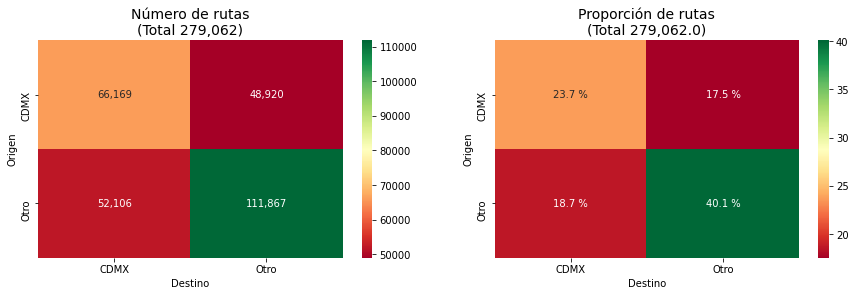

In [9]:
fig, ax = plt.subplots(1, 2, figsize=(15, 4))

sns.heatmap( rutas, annot=True, fmt='0,.0f', cmap='RdYlGn', ax=ax[0])
ax[0].set_title('Número de rutas\n(Total {:0,.0f})'.format(total_rutas), fontsize=14)

sns.heatmap( rutas_prop, annot=True, fmt='0,.1f', cmap='RdYlGn', ax=ax[1])
ax[1].set_title('Proporción de rutas\n(Total {:0,.1f})'.format(total_rutas), fontsize=14)
for t in ax[1].texts: t.set_text(t.get_text() + " %")


plt.show()

In [10]:
ruta_hora = data.groupby(['ori_cdmx', 'des_cdmx', 'hr']).size()
ruta_hora = ruta_hora.reset_index()  
ruta_hora.columns = ['Origen', 'Destino', 'hr', 'Rutas']

ruta0 = ruta_hora[ruta_hora['hr']==0].pivot_table(index='Origen', columns='Destino', values='Rutas')
ruta8 = ruta_hora[ruta_hora['hr']==8].pivot_table(index='Origen', columns='Destino', values='Rutas')
ruta16 = ruta_hora[ruta_hora['hr']==16].pivot_table(index='Origen', columns='Destino', values='Rutas')

ruta0_prop = ruta0.divide(ruta0.values.sum())*100
ruta8_prop = ruta8.divide(ruta8.values.sum())*100
ruta16_prop = ruta16.divide(ruta16.values.sum())*100

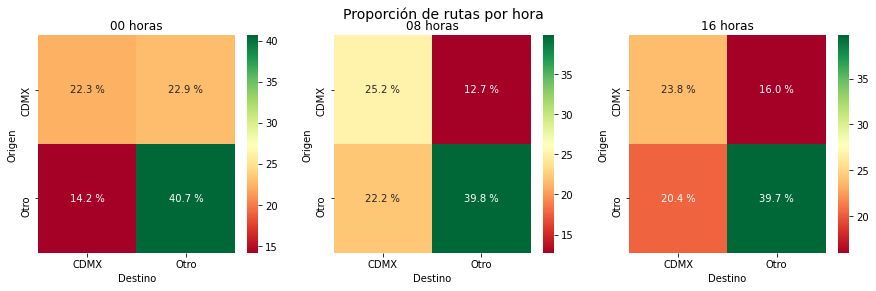

In [11]:
fig, ax = plt.subplots(1, 3, figsize=(15, 4))

sns.heatmap( ruta0_prop, annot=True, fmt='0,.1f', cmap='RdYlGn', ax=ax[0])
ax[0].set_title('00 horas')
for t in ax[0].texts: t.set_text(t.get_text() + " %")

sns.heatmap( ruta8_prop, annot=True, fmt='0,.1f', cmap='RdYlGn', ax=ax[1])
ax[1].set_title('08 horas')
for t in ax[1].texts: t.set_text(t.get_text() + " %")

sns.heatmap( ruta16_prop, annot=True, fmt='0,.1f', cmap='RdYlGn', ax=ax[2])
ax[2].set_title('16 horas')
for t in ax[2].texts: t.set_text(t.get_text() + " %")

fig.suptitle('Proporción de rutas por hora', fontsize=14)
plt.show()
#plt.tight_layout()

### Número de personas transitando las rutas

En términos del número de personas que transitan las rutas el 95% se reparte entre rutas con origen y destino en la CDMX y, rutas con origen y destino fuera de la CDMX. El restante 5% de las personas que transitan, lo hace de municipios fuera de la CDMX a las alcaldías de la CDMX o viceversa.

In [12]:
ruta_hora = data.groupby(['ori_cdmx', 'des_cdmx', 'hr']).sum()['crisis_people_moving']
ruta_hora = ruta_hora.reset_index()  
ruta_hora.columns = ['Origen', 'Destino', 'hr', 'Rutas']

ruta0 = ruta_hora[ruta_hora['hr']==0].pivot_table(index='Origen', columns='Destino', values='Rutas')
ruta8 = ruta_hora[ruta_hora['hr']==8].pivot_table(index='Origen', columns='Destino', values='Rutas')
ruta16 = ruta_hora[ruta_hora['hr']==16].pivot_table(index='Origen', columns='Destino', values='Rutas')

ruta0_prop = ruta0.divide(ruta0.values.sum())*100
ruta8_prop = ruta8.divide(ruta8.values.sum())*100
ruta16_prop = ruta16.divide(ruta16.values.sum())*100

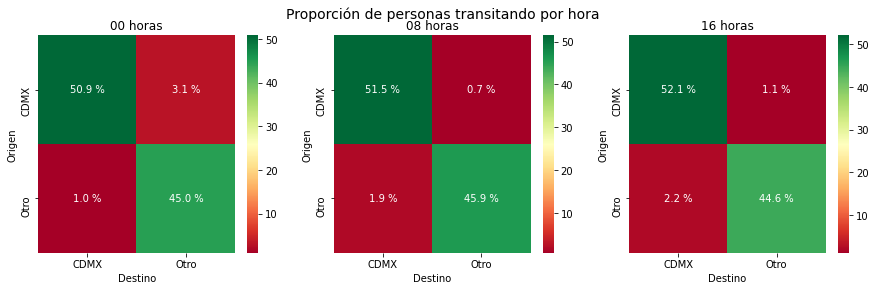

In [13]:
fig, ax = plt.subplots(1, 3, figsize=(15, 4))

sns.heatmap( ruta0_prop, annot=True, fmt='0,.1f', cmap='RdYlGn', ax=ax[0])
ax[0].set_title('00 horas')
for t in ax[0].texts: t.set_text(t.get_text() + " %")

sns.heatmap( ruta8_prop, annot=True, fmt='0,.1f', cmap='RdYlGn', ax=ax[1])
ax[1].set_title('08 horas')
for t in ax[1].texts: t.set_text(t.get_text() + " %")

sns.heatmap( ruta16_prop, annot=True, fmt='0,.1f', cmap='RdYlGn', ax=ax[2])
ax[2].set_title('16 horas')
for t in ax[2].texts: t.set_text(t.get_text() + " %")

fig.suptitle('Proporción de personas transitando por hora', fontsize=14)
plt.show()

# Inter-rutas e Intra-rutas

Separaremos el análisis para considerar dos conjuntos de datos:

   1. Inter-rutas: Rutas cuyo origen y destino pertenece a municipios o alcaldías diferentes 
   2. Intra-rutas: Rutas con origen y destino en el mismo municipio o alcandía

También haremos el análisis de las rutas separandolas según la ventana de tiempo en que se recorrieron:

   - 08 horas: de las 01:00 a las 8:00 horas
   - 16 horas: de las 09:00 a las 16:00 horas
   - 00 horas: de las 07:00 a las 24:00 horas
 
El número de rutas en cada caso son las siguientes:

| Tipo  | 08 horas | 16 horas | 00 horas | Total |
|:-----:|:--------:|:--------:|:--------:|:-----:|
|Inter-rutas|  1,140   |  1,250   |   1,372  | 3,762 |
|Intra-rutas|     66   |     66   |      66  |   198 |
|Total  |  1,206   |   1,316  |    1,438 | 3,960 |


Estas rutas consideran todos los dias, de lunes a domingo.

In [14]:
# Definimos los conjuntos de datos 
# Rutas entre alcaldias/municipios
inter_rutas = data[data['starting_region_name']!=data['ending_region_name']]

# Rutas en el mismo municipio/alcaldia
intra_rutas = data[data['starting_region_name']==data['ending_region_name']]

In [15]:
# Number of unique rutes in each set of data
print("Inter: ", inter_rutas['ruta'].unique().shape[0])
print("Intra: ", intra_rutas['ruta'].unique().shape[0])

Inter:  1505
Intra:  66


In [16]:
#numero de rutas por horario
hora = 16
len(inter_rutas.groupby(['hr', 'ruta']).size().loc[(hora,)])

len(intra_rutas.groupby(['hr','ruta']).size().loc[(hora,)])

66

In [114]:
# Funcion para determinar las rutas que pertenecen a los grupos
# los grupos se calculan con base al promedio 
def rutas_con_reduccion_mayor_al_thr(df_rutas, y_info, threshold):
    bins =  [-500, threshold, 500]
    # Encontramos los cuartiles
    grupos = pd.cut(y_info, bins)
    
    index_grupo =  grupos[grupos == grupos.cat.categories[1]].index
    grupo = df_rutas.loc[index_grupo]

    return grupo

In [130]:
def bins_para_graficar(df_rutas, y_info):
    grupo = []
    
    bins =  [-40, -30, -20, -10, 0, 10, 20, 500]
    # Encontramos los cuartiles
    grupos = pd.cut(y_info, bins)
    
      
    for i in grupos.cat.categories:
        index_grupo =  grupos[grupos == grupos.cat.categories[0]].index
        grupo_cat = df_rutas.loc[index_grupo]
        grupo.append(grupo_cat)

    return grupo, grupos.cat.categories

In [129]:
# Graficas por grupos
# Cambio porcentual diario por ruta, todo el periodo

#rutas = grupo1.index
#dias = grupo1.columns

def grafica_cambio_en_en_tiempo_grupos(df_grupo, rutas, subtitulo):
    #df_grupo: df que contiene las rutas
    #rutas: array con los nombres de las rutas
    #dias: array con los dias del periodo
    #group_name: str con el nombre del grupo
    #flag: para cambiar el titulo
    
    fig = go.Figure()
        
    for ruta in rutas:
        #ax.plot(df_grupo.loc[ruta])
        fig.add_trace(go.Scatter(x=df_grupo.columns, y=df_grupo.loc[ruta], name=ruta, hovertext=ruta))
        
        fig.add_shape(
            # Line Vertical
            dict(
                type="line",
                x0=datetime.datetime(2020, 3, 23),
                y0=min(df_grupo.loc[ruta]),
                x1=datetime.datetime(2020, 3, 23),
                y1=max(df_grupo.loc[ruta]),
                line=dict(
                color="Red",
                width=3)
        )
    )
        
    titulo = 'Rutas con reducciones promedio en el periodo menores al 40% <br> {}'.format(subtitulo)
        
    fig.update_layout( 
        yaxis = dict(
            tickmode = 'linear',
            tick0 = -100, #round(min(df_grupo.loc[ruta])) ,
            dtick = 10
            ),
        title=titulo,
        yaxis_title="Porcentaje de cambio con respecto al baseline",
        xaxis_title="Dias",
        #legend_title="Legend Title",
        font=dict(
            #family="Courier New, monospace",
            size=12,
            color="Black"),
        showlegend=False,
        autosize=False,
        width=1000,
        height=500,
    )    
    
    fig.show()

# Inter-rutas: Lunes a Viernes

Rutas que de Lunes a viernes tuvieron una disminución menor al 40% en el periodo de interés (del 23 de marzo en adelante)

## 1. Ventana de tiempo: 08 horas 



In [107]:
lista_dias = ['Lunes', 'Martes', 'Miércoles', 'Jueves', 'Viernes']
UMBRAL_CAMBIO_PORCENTUAL = -40

In [76]:
# Rutas registradas en la ventana de las 8 horas de Lunes a Viernes
inter_rutas_8hr = inter_rutas.loc[(inter_rutas['hr']==8) & (inter_rutas['dia_semana']!='Sábado') &
                                  (inter_rutas['dia_semana']!='Domingo')]
inter_rutas_8hr_panel = inter_rutas_8hr.groupby(['ruta', 'fecha']).mean()['percent_change'].unstack()

In [146]:
# Calculamos el promedio de cambio a partir del 23 de marzo
# No se tiene info para 72 rutas en ese periodo
avg_change_8hr = inter_rutas_8hr_panel.loc[:,'2020-03-23':].mean(axis=1, skipna=True)

# Determinacion de los intervalos para los grupos
# Usamos el UMBRAL_CAMBIO_PORCENTUAL
grupo_8h =  rutas_con_reduccion_mayor_al_thr(inter_rutas_8hr_panel, avg_change_8hr, UMBRAL_CAMBIO_PORCENTUAL)
print('Número de rutas con reducciones menores al 40%: ', grupo_8h.shape[0])


Número de rutas con reducciones menores al 40%:  358


In [145]:
grupos_grafica, subinterval = bins_para_graficar(inter_rutas_8hr_panel, avg_change_8hr)
    
for i in range(0,len(grupos_grafica)):
    rutas = grupos_grafica[i].index
    grafica_cambio_en_en_tiempo_grupos(grupos_grafica[i], rutas, str(subinterval[i]) )


## 2. Ventana de tiempo: 16 horas 



In [153]:
# Rutas registradas en la ventana de las 8 horas de Lunes a Viernes
inter_rutas_16hr = inter_rutas.loc[(inter_rutas['hr']==16) & (inter_rutas['dia_semana']!='Sábado') &
                                  (inter_rutas['dia_semana']!='Domingo')]
inter_rutas_16hr_panel = inter_rutas_16hr.groupby(['ruta', 'fecha']).mean()['percent_change'].unstack()

In [155]:
# Calculamos el promedio de cambio a partir del 23 de marzo
# No se tiene info para 72 rutas en ese periodo
avg_change_16hr = inter_rutas_16hr_panel.loc[:,'2020-03-23':].mean(axis=1, skipna=True)

# Determinacion de los intervalos para los grupos
# Usamos el UMBRAL_CAMBIO_PORCENTUAL
grupo_16h =  rutas_con_reduccion_mayor_al_thr(inter_rutas_16hr_panel, avg_change_16hr, UMBRAL_CAMBIO_PORCENTUAL)
print('Número de rutas con reducciones menores al 40%: ', grupo_16h.shape[0])

Número de rutas con reducciones menores al 40%:  439


In [156]:
grupos_grafica, subinterval = bins_para_graficar(inter_rutas_16hr_panel, avg_change_16hr)
    
for i in range(0,len(grupos_grafica)):
    rutas = grupos_grafica[i].index
    grafica_cambio_en_en_tiempo_grupos(grupos_grafica[i], rutas, str(subinterval[i]) )

## 3. Ventana de tiempo: 00 horas 



In [158]:
# Rutas registradas en la ventana de las 8 horas de Lunes a Viernes
inter_rutas_0hr = inter_rutas.loc[(inter_rutas['hr']==0) & (inter_rutas['dia_semana']!='Sábado') &
                                  (inter_rutas['dia_semana']!='Domingo')]
inter_rutas_0hr_panel = inter_rutas_0hr.groupby(['ruta', 'fecha']).mean()['percent_change'].unstack()

In [159]:
# Calculamos el promedio de cambio a partir del 23 de marzo
# No se tiene info para 72 rutas en ese periodo
avg_change_0hr = inter_rutas_0hr_panel.loc[:,'2020-03-23':].mean(axis=1, skipna=True)

# Determinacion de los intervalos para los grupos
# Usamos el UMBRAL_CAMBIO_PORCENTUAL
grupo_0h =  rutas_con_reduccion_mayor_al_thr(inter_rutas_0hr_panel, avg_change_0hr, UMBRAL_CAMBIO_PORCENTUAL)
print('Número de rutas con reducciones menores al 40%: ', grupo_0h.shape[0])

Número de rutas con reducciones menores al 40%:  461


In [160]:
grupos_grafica, subinterval = bins_para_graficar(inter_rutas_0hr_panel, avg_change_0hr)
    
for i in range(0,len(grupos_grafica)):
    rutas = grupos_grafica[i].index
    grafica_cambio_en_en_tiempo_grupos(grupos_grafica[i], rutas, str(subinterval[i]) )

In [163]:
### Guardamos la informacion de las rutas
grupo_8h.to_csv("~/bj/data/rutas/rutas_8hr.csv")
grupo_16h.to_csv("~/bj/data/rutas/rutas_16hr.csv")
grupo_0h.to_csv("~/bj/data/rutas/rutas_0hr.csv")

In [164]:
nombre_rutas = dict({'8h': grupo_8h.index, '16h': grupo_16h.index, '0h': grupo_0h.index})

In [184]:
df = pd.DataFrame.from_dict(nombre_rutas, orient='index')
df = df.transpose()
df.head(20)

,8h,16h,0h
0,Acolman - Atenco,Acolman - Atenco,Acolman - Atenco
1,Acolman - Azcapotzalco,Acolman - Benito Juárez,Acolman - Chiautla
2,Acolman - Chiautla,Acolman - Chiautla,Acolman - Coacalco de Berriozábal
3,Acolman - Ecatepec de Morelos,Acolman - Coacalco de Berriozábal,Acolman - Ecatepec de Morelos
4,Acolman - Tecámac,Acolman - Ecatepec de Morelos,Acolman - Nezahualcóyotl
5,Acolman - Teotihuacán,Acolman - Nezahualcóyotl,Acolman - Tecámac
6,Acolman - Tezoyuca,Acolman - Tecámac,Acolman - Teotihuacán
7,Acolman - Tlalnepantla de Baz,Acolman - Teotihuacán,Acolman - Texcoco
8,Acolman - Tultitlán,Acolman - Tezoyuca,Acolman - Tezoyuca
9,Acolman - Venustiano Carranza,Acolman - Tlalnepantla de Baz,Amecameca - Tlalmanalco


In [182]:
len(set(grupo_8h.index.values).union(grupo_16h.index.values, grupo_0h.index.values))


770